# Assignment 3 | Listening With Campus

Here is some original data exploration and analysis from the listening with campus survey

In [137]:
# import modules
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
from itertools import product
from matplotlib.colors import ListedColormap
import math
from io import BytesIO
from PIL import Image
import requests
from datetime import datetime

In [2]:
# Import the data
filename = 'data.csv'
data_raw = pd.read_csv(filename)

# Get the data and the lables
data  = data_raw.to_numpy().T
keys  = data_raw.keys().to_numpy()
DATA  = {K:D for K,D in zip(keys,data)}

data_raw

,ObjectID,GlobalID,CreationDate,Creator,EditDate,Editor,What word best describes this sound?,On a scale from 1 to 5 how loud was this sound?,What kind of sound is this?,Other - What kind of sound is this?,On a scale from 1 to 5 how loud was this sound? (from most faint to loudest),Is there anything else we need to know about this sound?,Are you outdoors or indoors?,"What level are you on? (0 = ground, 9= 9th floor or higher)",x,y
0,1,b67b9b07-2914-4ea4-b0f4-36c5e11eab6e,3/27/2022 7:45:15 AM,adsp22_as13966,3/27/2022 7:45:15 AM,adsp22_as13966,A/C,NaN,Machine,NaN,Faint 1,A/C sound in Unix Lab,NaN,NaN,54.434619,24.524209
1,2,a16ec83d-b6b9-4705-80cd-54078f411ed8,3/27/2022 7:50:08 AM,adsp22_as13966,3/27/2022 7:50:08 AM,adsp22_as13966,Students in front of Library,NaN,Human,NaN,2,"Sunday morning, very quiet",NaN,NaN,54.434325,24.524123
2,3,1f702c42-b33d-4858-8fa1-b5ffed98b7f7,3/27/2022 7:51:26 AM,adsp22_as13966,3/27/2022 7:51:26 AM,adsp22_as13966,Hydrologi water dispenser,NaN,Machine,NaN,3,Processing water,NaN,NaN,54.434669,24.523925
3,4,6c7f72b2-aab6-4bff-99e1-89ec4ea6267c,3/27/2022 7:53:29 AM,adsp22_as13966,3/27/2022 7:53:29 AM,adsp22_as13966,Birds signing,NaN,Natural,NaN,2,On top of the Arts Center,NaN,NaN,54.435085,24.523591
4,5,6d28813b-2808-4730-87a1-0d9cdb55db9a,3/27/2022 7:54:39 AM,adsp22_as13966,3/27/2022 7:54:39 AM,adsp22_as13966,Wind,NaN,Natural,NaN,2,Windy day in front of A5A,NaN,NaN,54.434775,24.523340
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
520,525,ec37e106-9d40-49c3-aa1d-f9bc0d5e3759,5/10/2022 5:08:39 AM,adsp22_mim7995,5/10/2022 5:08:39 AM,adsp22_mim7995,Garbage trolleys,NaN,Machine,NaN,3,Near palms 9am,Outdoors,0.0,54.434193,24.523733
521,526,9178e026-ea5a-45d6-abb6-6c8ea89af561,5/10/2022 5:09:21 AM,adsp22_mim7995,5/10/2022 5:09:21 AM,adsp22_mim7995,Construction,NaN,Machine,NaN,3,Near A2,Outdoors,0.0,54.433973,24.524179
522,527,8b7e513b-3d13-4f2c-840d-e7863b4a5a70,5/10/2022 5:10:35 AM,adsp22_mim7995,5/10/2022 5:10:35 AM,adsp22_mim7995,Footsteps,NaN,Human,NaN,4,Students walking to classes 9am,Indoors,0.0,54.433774,24.524599
523,528,b1d6ce50-697e-4b32-bdc8-6f45b00bf14d,5/10/2022 5:10:54 AM,adsp22_mim7995,5/10/2022 5:10:54 AM,adsp22_mim7995,Professor speaking,NaN,Human,NaN,Loud 5,NaN,Indoors,0.0,54.434211,24.523828


In [3]:
# Define some useful functions
def get_idx(array):
    '''Return the index set that the array is not NaN'''
    return [True if type(d)==str else not np.isnan(d) for d in array]

def jitter(array,amount = 0.1):
    '''Adds random jitter to the data'''
    return array + 2*amount*(np.random.rand(len(array))-0.5)

In [124]:
# Convert the data to a list without NANs
loudness = DATA['On a scale from 1 to 5 how loud was this sound? (from most faint to loudest)']
floor    = DATA['What level are you on?  (0 = ground, 9= 9th floor or higher)']
idx_flor = get_idx(floor)
idx_loud = get_idx(loudness)
idx      = np.array(idx_flor)*np.array(idx_loud)

loud = loudness[idx_loud]
loud = np.array([float("".join(filter(str.isdigit,i))) for i in loud])
flor = floor[idx]

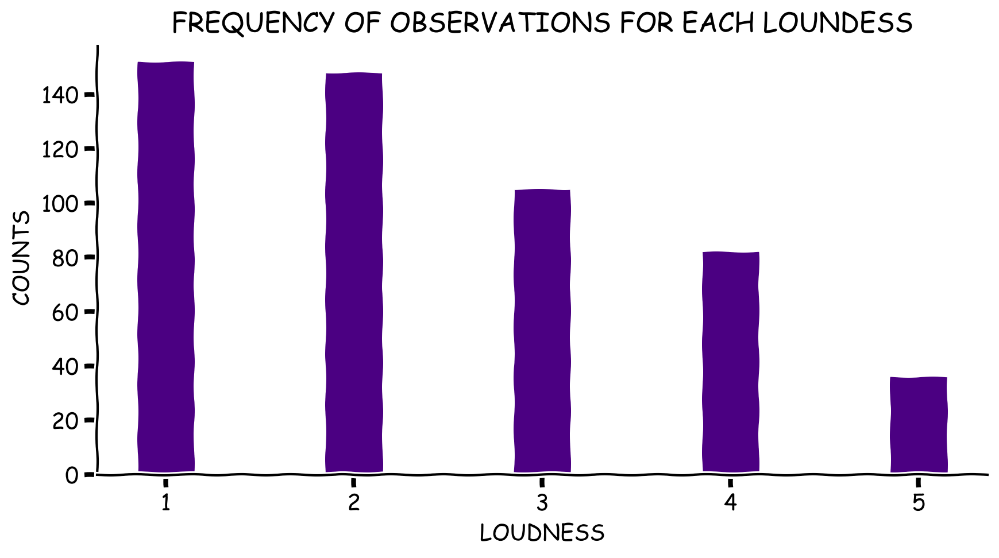

In [131]:
# Plot loudness counts
plt.xkcd()

# Plot the histograms
fig = plt.figure(figsize=(10,5),dpi=200)
ax1 = fig.add_subplot(111)

# Plot the data
ax1.bar(*np.unique(loud,return_counts=True),0.30,color='indigo')

# ANNOTATE
# ax1.annotate(
#     "NOT SURE WHAT THIS IS, BUT IT\nDOESN'T SEEM TO BE USED ANYWAY.",
#     xy=(5, 100), arrowprops=dict(arrowstyle='->'), xytext=(2, 3000))

# Add labels etc.
ax1.set_xlabel('LOUDNESS')
ax1.set_ylabel('COUNTS')
ax1.set_title("FREQUENCY OF OBSERVATIONS FOR EACH LOUNDESS")
# ax1.set_xticklabels([x.upper() for x in category_labels],fontsize=10)
ax1.spines.right.set_color('none')
ax1.spines.top.set_color('none')

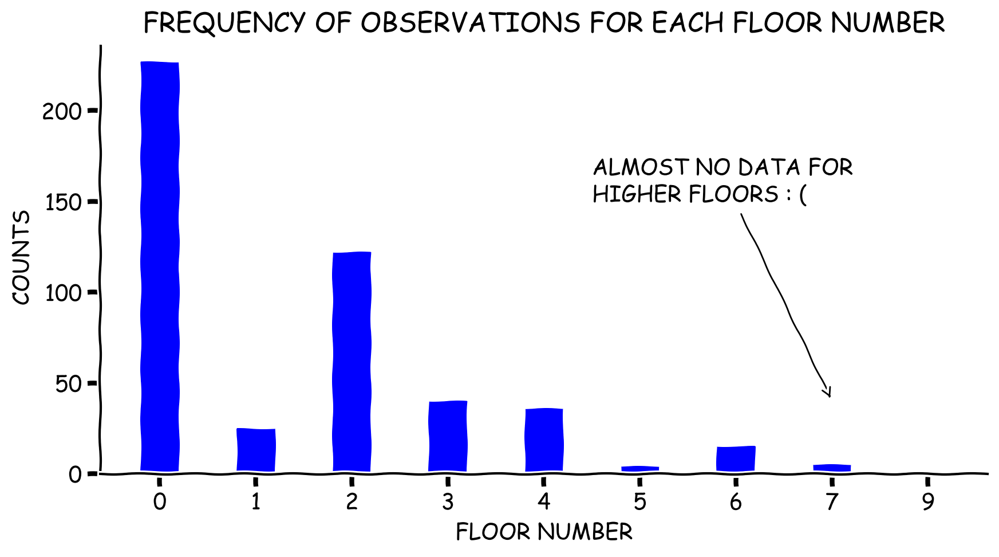

In [322]:
# Plot loudness counts
plt.xkcd()

# Plot the histograms
fig = plt.figure(figsize=(10,5),dpi=200)
ax1 = fig.add_subplot(111)

# Plot the data
n, cnt = np.unique(flor,return_counts=True)
n = [str(int(c)) for c in n]
ax1.bar(n,cnt,0.40,color='blue')

# ANNOTATE
ax1.annotate(
    "ALMOST NO DATA FOR \nHIGHER FLOORS : (",
    xy=('7', 40), arrowprops=dict(arrowstyle='->'), xytext=(4.5, 150))

# Add labels etc.
ax1.set_xlabel('FLOOR NUMBER')
ax1.set_ylabel('COUNTS')
ax1.set_title("FREQUENCY OF OBSERVATIONS FOR EACH FLOOR NUMBER")
ax1.spines.right.set_color('none')
ax1.spines.top.set_color('none')

# plt.bar(*np.unique(flor,return_counts=True));

In [8]:
# Plots that I will do are:

# Loudness field overlayed on map
# Clustering of loudness and description (somehow manage to get an emotion out of text)

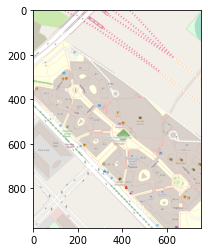

In [9]:
# Plotting on a map
# Tutotial from here: https://bryanbrattlof.com/adding-openstreetmaps-to-matplotlib/

# The url of openstreetmap
URL = "https://tile.openstreetmap.org/{z}/{x}/{y}.png".format
TILE_SIZE = 256
zoom = 10

# Get all the tiles of the map together
def point_to_pixels(lon, lat, zoom):
    """convert gps coordinates to web mercator"""
    r = math.pow(2, zoom) * TILE_SIZE
    lat = math.radians(lat)

    x = int((lon + 180.0) / 360.0 * r)
    y = int((1.0 - math.log(math.tan(lat) + (1.0 / math.cos(lat))) / math.pi) / 2.0 * r)

    return x, y

# Now we will get the data for the outdoors scents
x_out = DATA['x'] #[np.where(data[12] == 'Outdoors')[0]]
x_out = np.array([x for x in x_out if x != 0])

y_out = DATA['y'] #[np.where(data[12] == 'Outdoors')[0]]
y_out = np.array([y for y in y_out if y != 0])

# Get the conrer coordinates
top, bot = y_out.max(), y_out.min()
lef, rgt = x_out.min(), x_out.max()

# Find the map patches
zoom = 18
x0, y0 = point_to_pixels(lef, top, zoom)
x1, y1 = point_to_pixels(rgt, bot, zoom)

x0_tile, y0_tile = int(x0 / TILE_SIZE), int(y0 / TILE_SIZE)
x1_tile, y1_tile = math.ceil(x1 / TILE_SIZE), math.ceil(y1 / TILE_SIZE)

assert (x1_tile - x0_tile) * (y1_tile - y0_tile) < 50, "That's too many tiles!"

# full size image we'll add tiles to
img = Image.new('RGB', (
    (x1_tile - x0_tile) * TILE_SIZE,
    (y1_tile - y0_tile) * TILE_SIZE))

# loop through every tile inside our bounded box
for x_tile, y_tile in product(range(x0_tile, x1_tile), range(y0_tile, y1_tile)):
    with requests.get(URL(x=x_tile, y=y_tile, z=zoom)) as resp:
        tile_img = Image.open(BytesIO(resp.content))

    # add each tile to the full size image
    img.paste(
        im=tile_img,
        box=((x_tile - x0_tile) * TILE_SIZE, (y_tile - y0_tile) * TILE_SIZE))

# Crop the image
x, y = x0_tile * TILE_SIZE, y0_tile * TILE_SIZE
img = img.crop((int(x0-x),int(y0-y),int(x1-x),int(y1-y)))
plt.imshow(img)

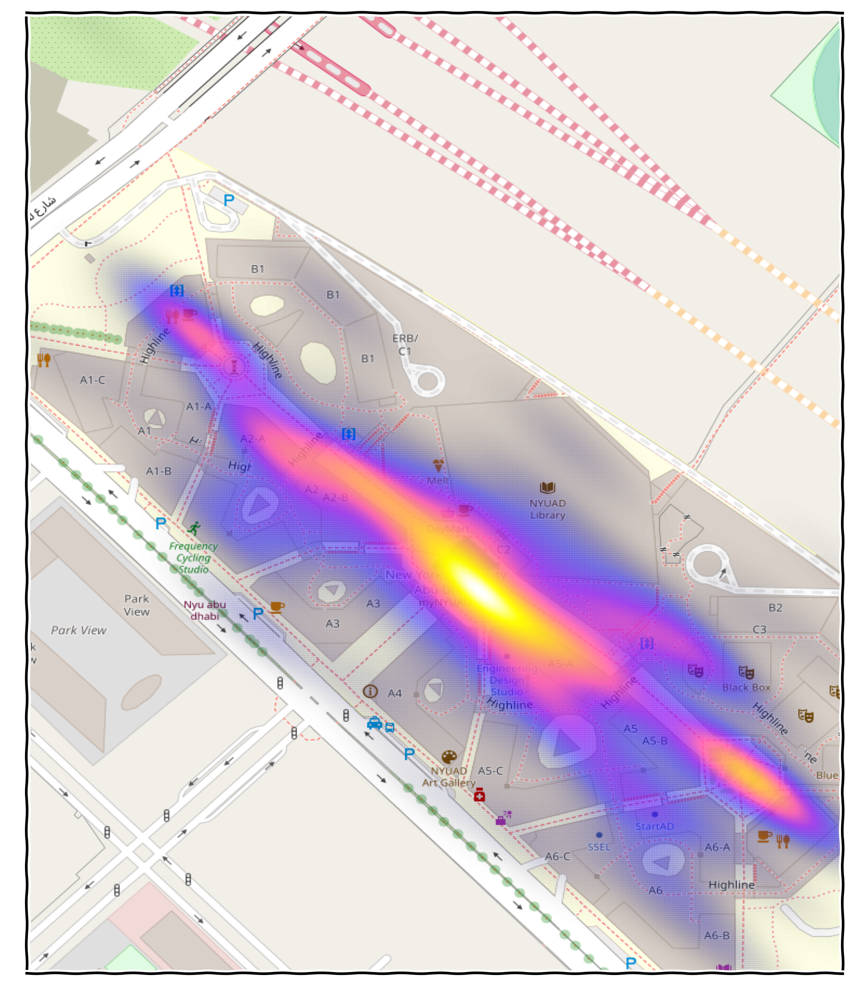

In [239]:
plt.xkcd()

# Plot main trends
fig = plt.figure(figsize=(10,10),dpi=300)
ax  = fig.add_subplot(111)

# Now we will get the data for both scents
x_out = DATA['x'] #[np.where(data[12] == 'Outdoors')[0]]
x_out = np.array([x for x in x_out if x != 0])

y_out = DATA['y'] #[np.where(data[12] == 'Outdoors')[0]]
y_out = np.array([y for y in y_out if y != 0])

# ax.scatter(x_out,y_out,s=1)
ax.imshow(img,extent=(lef, rgt, bot, top))

nbins= 500
k    = gaussian_kde([x_out,y_out],0.25)
K    = gaussian_kde([x_out,y_out],0.25)
X, Y = np.mgrid[x_out.min():x_out.max():nbins*1j,y_out.min():y_out.max():nbins*1j]
Z    = k(np.vstack([X.flatten(),Y.flatten()]))

cmap = plt.cm.gnuplot2
my_cmap = cmap(np.arange(cmap.N))
my_cmap[:, 3] = np.linspace(0, 1, cmap.N)
my_cmap = ListedColormap(my_cmap)

ax.pcolormesh(X, Y, Z.reshape(X.shape), shading='gouraud', cmap=my_cmap)
ax = plt.gca()
ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)

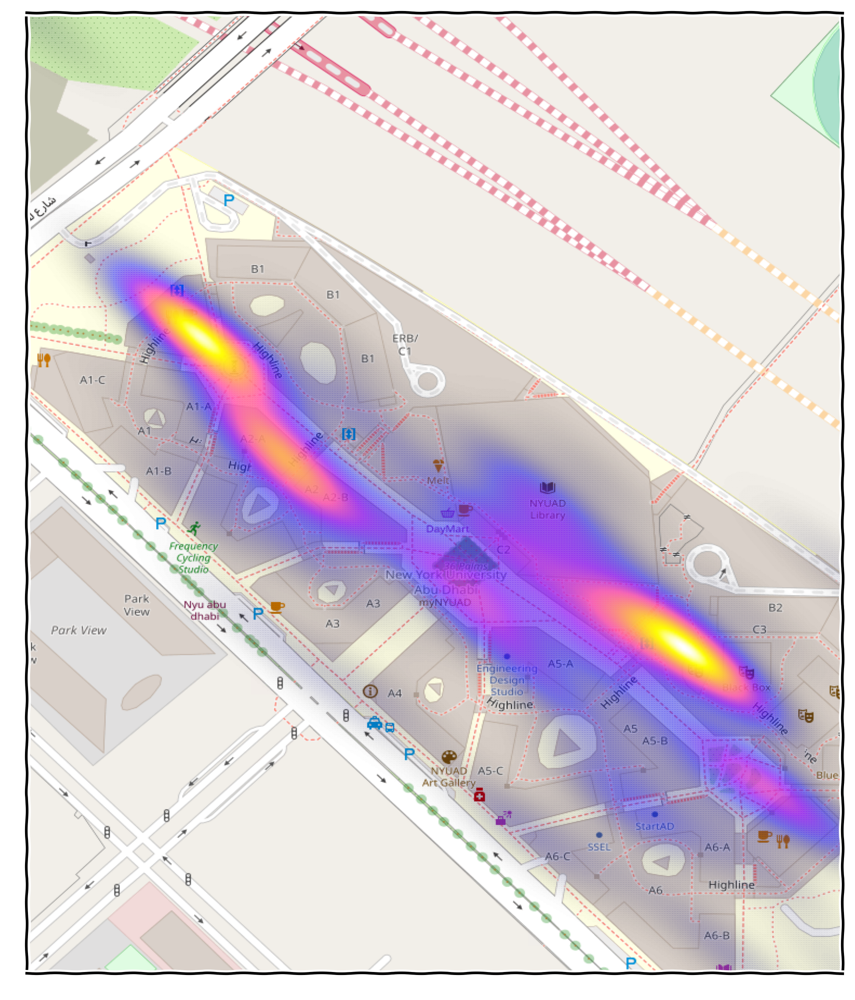

In [240]:
# Plot Loudness
fig = plt.figure(figsize=(10,10),dpi=300)
ax  = fig.add_subplot(111) 

# Now we will get the data for both scents
x_out = DATA['x'][np.where(data[10] == 'Faint 1')[0]]
x_out = np.array([x for x in x_out if x != 0]+[lef,rgt])

y_out = DATA['y'][np.where(data[10] == 'Faint 1')[0]]
y_out = np.array([y for y in y_out if y != 0]+[top,bot])

# ax.scatter(x_out,y_out,s=1)
ax.imshow(img,extent=(lef, rgt, bot, top))

nbins= 500
k    = gaussian_kde([x_out,y_out],0.25)
X, Y = np.mgrid[x_out.min():x_out.max():nbins*1j,y_out.min():y_out.max():nbins*1j]
Z    = k(np.vstack([X.flatten(),Y.flatten()]))

cmap = plt.cm.gnuplot2
my_cmap = cmap(np.arange(cmap.N))
my_cmap[:, 3] = np.linspace(0, 1, cmap.N)
my_cmap = ListedColormap(my_cmap)

ax.pcolormesh(X, Y, Z.reshape(X.shape), shading='gouraud', cmap=my_cmap)
ax.set_xlim(lef,rgt)
ax = plt.gca()
ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)

In [241]:
def plot_loudness(ax,key='Faint 1',cmap=plt.cm.gnuplot2,scale:bool=False):
    # Now we will get the data for both scents
    x_out = DATA['x'][np.where(data[10] == key)[0]]
#     x_out = np.array([x for x in x_out if x != 0]+[lef,rgt])
    x_out = np.array([x for x in x_out if x != 0])

    y_out = DATA['y'][np.where(data[10] == key)[0]]
#     y_out = np.array([y for y in y_out if y != 0]+[top,bot])
    y_out = np.array([y for y in y_out if y != 0])

    # ax.scatter(x_out,y_out,s=1)
    ax.imshow(img,extent=(lef, rgt, bot, top))

    nbins= 500
    k    = gaussian_kde([x_out,y_out],0.25)
    if scale: k = gaussian_kde([x_out,y_out],0.25,weights=1/K.evaluate([x_out,y_out]))
    X, Y = np.mgrid[min(x_out.min(),lef):max(x_out.max(),rgt):nbins*1j,min(y_out.min(),bot):max(y_out.max(),top):nbins*1j]
    Z    = k(np.vstack([X.flatten(),Y.flatten()]))
    
    my_cmap = cmap(np.arange(cmap.N))
    my_cmap[:, 3] = np.linspace(0, .7, cmap.N)
    my_cmap = ListedColormap(my_cmap)

    ax.pcolormesh(X, Y, Z.reshape(X.shape), shading='gouraud', cmap=my_cmap)
    ax.set_xlim(lef,rgt)
    ax.axes.xaxis.set_visible(False)
    ax.axes.yaxis.set_visible(False)
    ax.set_title(key,fontsize=30,pad=30)

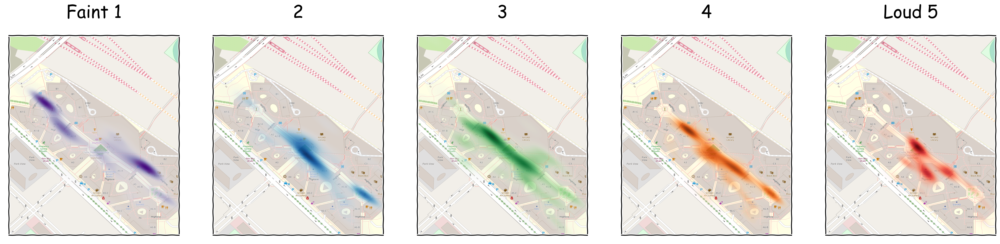

In [242]:
# Plot main trends
fig,ax = plt.subplots(1,5,figsize=(30,10),dpi=300)
# fig.suptitle('LOUDNESS DISTRIBUTION ON CAMPUS')
louds  = ['Faint 1','2', '3', '4', 'Loud 5']
cmaps  = [plt.cm.Purples,plt.cm.Blues,plt.cm.Greens,plt.cm.Oranges,plt.cm.Reds]

for a, key, cmap in zip(ax,louds,cmaps):
    plot_loudness(a,key,cmap)

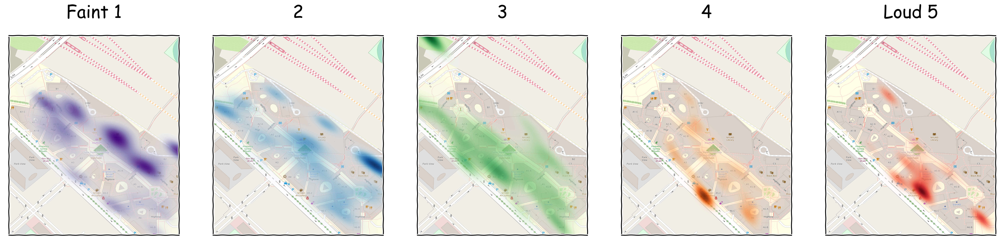

In [243]:
# Plot main trends
fig,ax = plt.subplots(1,5,figsize=(30,10),dpi=300)
# fig.suptitle('LOUDNESS DISTRIBUTION ON CAMPUS')
louds  = ['Faint 1','2', '3', '4', 'Loud 5']
cmaps  = [plt.cm.Purples,plt.cm.Blues,plt.cm.Greens,plt.cm.Oranges,plt.cm.Reds]

for a, key, cmap in zip(ax,louds,cmaps):
    plot_loudness(a,key,cmap,scale=True)

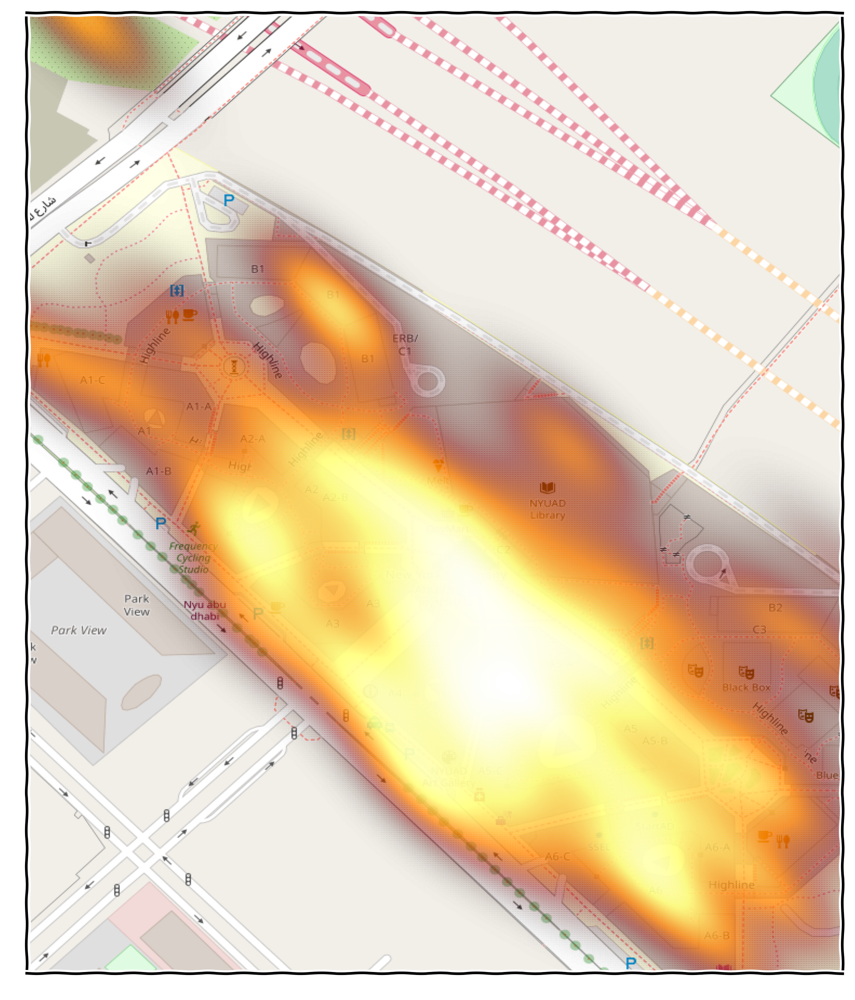

In [244]:
plt.xkcd()

# Plot main trends
fig = plt.figure(figsize=(10,10),dpi=300)
ax  = fig.add_subplot(111)

# Now we will get the data for both scents
x_out = DATA['x'] [get_idx(data[10])]
x_out = np.array([x for x in x_out if x != 0])

y_out = DATA['y'][get_idx(data[10])]
y_out = np.array([y for y in y_out if y != 0])

# ax.scatter(x_out,y_out,s=1)
ax.imshow(img,extent=(lef, rgt, bot, top))

nbins= 500
scale= np.array([float("".join(filter(str.isdigit,i))) for i in data[10][get_idx(data[10])]])[np.where(DATA['y'][get_idx(data[10])] != 0)[0]]
k    = gaussian_kde([x_out,y_out],0.25,weights=scale/K.evaluate([x_out,y_out]))
X, Y = np.mgrid[x_out.min():x_out.max():nbins*1j,y_out.min():y_out.max():nbins*1j]
Z    = k(np.vstack([X.flatten(),Y.flatten()]))

cmap = plt.cm.afmhot
my_cmap = cmap(np.arange(cmap.N))
my_cmap[:, 3] = np.linspace(0, 1, cmap.N)
my_cmap = ListedColormap(my_cmap)

ax.pcolormesh(X, Y, Z.reshape(X.shape), shading='gouraud', cmap=my_cmap)
ax = plt.gca()
ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)

In [247]:
def plot_student(ax,student,cmap=plt.cm.Reds,scale:bool=False):
    # Now we will get the data for both scents
    x_out = DATA['x'][np.where(data[3] == student)[0]]
    x_out = np.array([x for x in x_out if x != 0])
#     print(x_out)

    y_out = DATA['y'][np.where(data[3] == student)[0]]
    y_out = np.array([y for y in y_out if y != 0])

    # ax.scatter(x_out,y_out,s=1)
    ax.imshow(img,extent=(lef, rgt, bot, top))

    nbins= 500
    k    = gaussian_kde([x_out,y_out],0.3)
    if scale: k = gaussian_kde([x_out,y_out],weights=1/K.evaluate([x_out,y_out]))
    X, Y = np.mgrid[min(x_out.min(),lef):max(x_out.max(),rgt):nbins*1j,min(y_out.min(),bot):max(y_out.max(),top):nbins*1j]
    Z    = k(np.vstack([X.flatten(),Y.flatten()]))
    
    my_cmap = cmap(np.arange(cmap.N))
    my_cmap[:, 3] = np.linspace(0, 0.5, cmap.N)
    my_cmap = ListedColormap(my_cmap)

    ax.pcolormesh(X, Y, Z.reshape(X.shape), shading='gouraud', cmap=my_cmap)
    ax.set_xlim(lef,rgt)
    ax.axes.xaxis.set_visible(False)
    ax.axes.yaxis.set_visible(False)
#     ax.set_title(student,fontsize=30,pad=30)
    

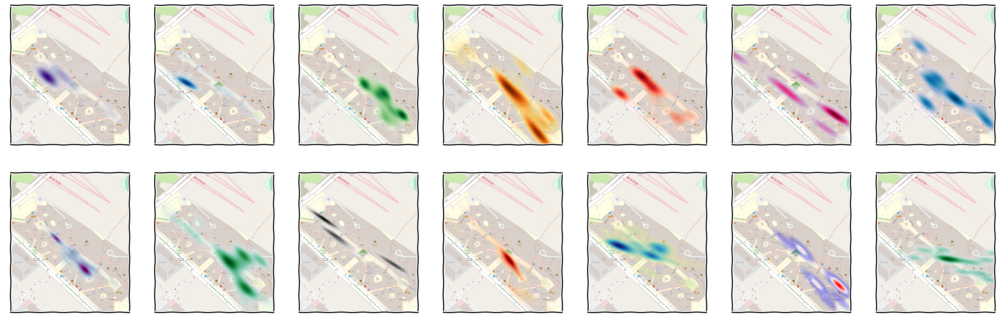

In [248]:
# Plot Loudness
fig,ax = plt.subplots(2,7,figsize=(25,8),dpi=200)
students = ['ADFA19_nks369', 'adsp22_amd1139', 'adsp22_as13966',
       'adsp22_gkm267', 'adsp22_ka1914', 'adsp22_kds490',
       'adsp22_mf3846', 'adsp22_mim7995', 'adsp22_ntn6039',
       'adsp22_pk2269', 'adsp22_po524', 'adsp22_sl7362', 'adsp22_ss13189', 'djw12_nyuad']

cmaps = [plt.cm.Purples,plt.cm.Blues,plt.cm.Greens,plt.cm.YlOrBr,plt.cm.Reds,plt.cm.PuRd,plt.cm.PuBu,plt.cm.BuPu,plt.cm.BuGn,plt.cm.Greys,plt.cm.OrRd,plt.cm.YlGnBu,plt.cm.bwr,plt.cm.BuGn,plt.cm.GnBu]

for i in range(len(students)):
    plot_student(ax.flatten()[i],students[i],cmaps[i])


In [323]:
# Level information
def plot_level(ax,level,cmap=plt.cm.Reds,scale:bool=False):
    x_out = DATA['x'][np.where(data[13] == level)[0]]
    x_out = np.array([x for x in x_out if x != 0])

    y_out = DATA['y'][np.where(data[13] == level)[0]]
    y_out = np.array([y for y in y_out if y != 0])

    # ax.scatter(x_out,y_out,s=1)
    ax.imshow(img,extent=(lef, rgt, bot, top))
    
    if len(x_out) > 3:
        nbins= 500
        k    = gaussian_kde([x_out,y_out])
        if scale: k = gaussian_kde([x_out,y_out],weights=1/K.evaluate([x_out,y_out]))
        X, Y = np.mgrid[min(x_out.min(),lef):max(x_out.max(),rgt):nbins*1j,min(y_out.min(),bot):max(y_out.max(),top):nbins*1j]
        Z    = k(np.vstack([X.flatten(),Y.flatten()]))

        my_cmap = cmap(np.arange(cmap.N))
        my_cmap[:, 3] = np.linspace(0, 0.5, cmap.N)
        my_cmap = ListedColormap(my_cmap)

        ax.pcolormesh(X, Y, Z.reshape(X.shape), shading='gouraud', cmap=my_cmap)

    ax.set_xlim(lef,rgt)
    ax.axes.xaxis.set_visible(False)
    ax.axes.yaxis.set_visible(False)
    ax.set_title("LEVEL "+str(int(level)),fontsize=26,pad=10)
    

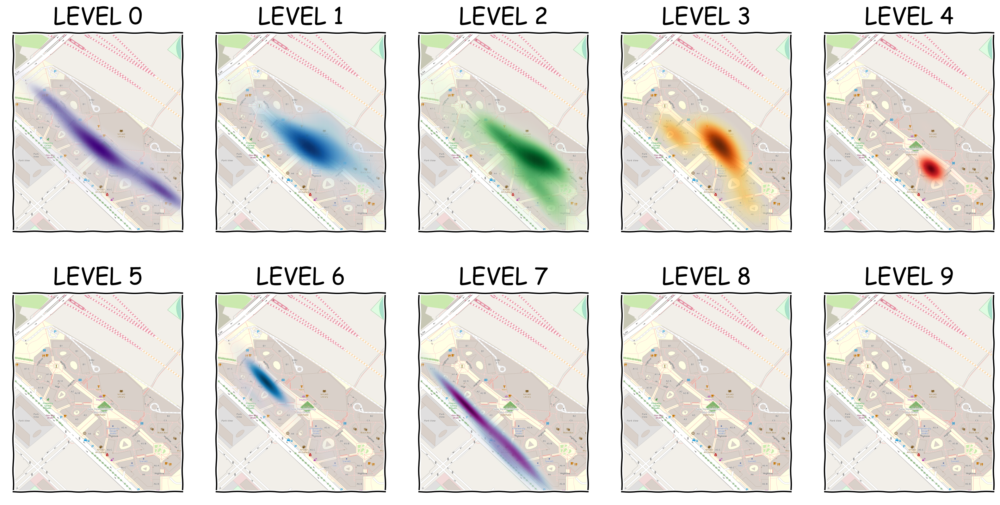

In [324]:
level = [0,1,2,3,4,5,6,7,8,9]
cmaps = [plt.cm.Purples,plt.cm.Blues,plt.cm.Greens,plt.cm.YlOrBr,plt.cm.Reds,plt.cm.PuRd,plt.cm.PuBu,plt.cm.BuPu,plt.cm.BuGn,plt.cm.Greys,plt.cm.OrRd,plt.cm.YlGnBu,plt.cm.bwr,plt.cm.BuGn,plt.cm.GnBu]
fig,ax = plt.subplots(2,5,figsize=(20,10),dpi=200)

for i in range(len(level)):
    plot_level(ax.flatten()[i],level[i],cmaps[i])


In [273]:
# GEt student timestamps
def plot_student_time(ax,student,m,M):
    # Collect data
    timestamps_n = [datetime.strptime(d,"%m/%d/%Y %H:%M:%S %p") for d in data[2][np.where(data[13]==student)[0]]]
    times        = np.array([d.timestamp() for d in timestamps_n])

    if len(times) > 2:
        k    = gaussian_kde(times,0.15)
        X    = np.linspace(m,M,200)
        Y    = k(X)
        x    = [datetime.fromtimestamp(d) for d in X]

        ax.plot(x,Y)

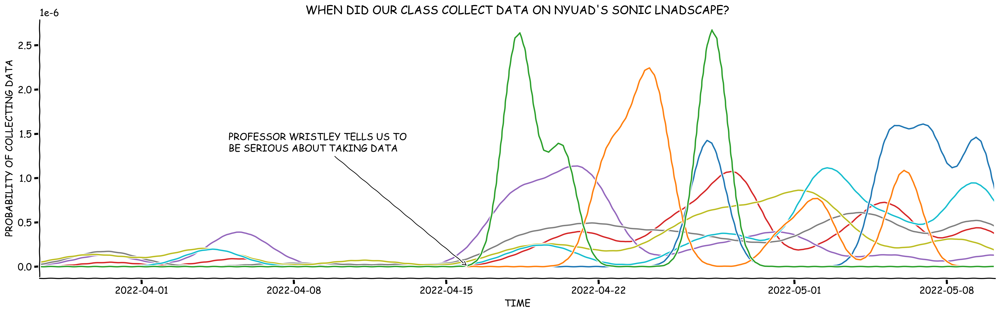

In [325]:
# User collection trendlines

# Create figure
fig = plt.figure(figsize=(25,7),dpi=300)
ax = fig.add_subplot(111)

# Collect data
# timestamps_n = [datetime.strptime(d,"%m/%d/%Y %H:%M:%S %p") for d in data[2][np.where(data[13]==student)[0]]]
timestamps_n = [datetime.strptime(d,"%m/%d/%Y %H:%M:%S %p") for d in data[2]]
times        = np.array([d.timestamp() for d in timestamps_n])

# n,x,_ = ax.hist(timestamps_n,bins=200,color='k',density=True,histtype='stepfilled');

k    = gaussian_kde(times,0.2)
m,M  = min(times),max(times)
X    = np.linspace(m,M,1000)
Y    = k(X)
x    = [datetime.fromtimestamp(d) for d in X]
# ax.plot(x,Y*4,c='k')

for student in np.unique(data[13]):
    plot_student_time(ax,student,m,M)
    
ax.set_xlim(datetime.fromtimestamp(m),datetime.fromtimestamp(M));

ax.set_xlabel('TIME')
ax.set_ylabel('PROBABILITY OF COLLECTING DATA')
ax.set_title("WHEN DID OUR CLASS COLLECT DATA ON NYUAD'S SONIC LNADSCAPE?")
# ax1.set_xticklabels([x.upper() for x in category_labels],fontsize=10)
ax.spines.right.set_color('none')
ax.spines.top.set_color('none')

# ANNOTATE
ax.annotate(
    "PROFESSOR WRISTLEY TELLS US TO \nBE SERIOUS ABOUT TAKING DATA",
    xy=(datetime.strptime('4/16/2022',"%m/%d/%Y"), 0), arrowprops=dict(arrowstyle='->'), 
    xytext=(datetime.strptime('4/5/2022',"%m/%d/%Y"), 1.3e-6));
